In [1]:
import os

import numpy as np
from matplotlib import pyplot as plt
import pytesseract
from PIL import Image, ImageDraw, ImageFont
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
import cv2 as cv

In [2]:
image = np.full((128,128,3),255)

In [3]:
image[30:60,30:60,1] = 0

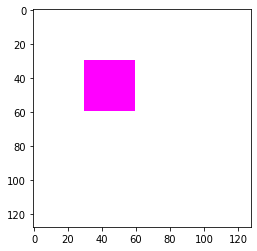

In [4]:
plt.imshow(image,interpolation="nearest")
plt.show()

In [5]:
roman_numeral_number_list = ["0","1","2","3","4","5","6","7","8","9",0,1,2,3,4,5,6,7,8,9]
font = ImageFont.load_default()

card_ds_path = "../../datasets/card_images/Card images"

### Using Tesseract OCR engine

In [6]:
image_list = os.listdir(card_ds_path)
image_list

['20220123_105621.jpg',
 '20220123_105630.jpg',
 '20220123_105635.jpg',
 '20220123_105641.jpg',
 '20220123_105644.jpg',
 '20220123_105649.jpg',
 '20220123_105701.jpg',
 '20220123_105856.jpg',
 '20220123_105858.jpg',
 '20220123_105906.jpg',
 '20220123_105913.jpg',
 '20220123_105918.jpg',
 '20220123_105922.jpg',
 '20220129_185151.jpg',
 '20220129_185219.jpg',
 '20220129_185225.jpg',
 '20220129_185232.jpg',
 '20220129_185244.jpg',
 '20220129_185259.jpg',
 '20220226_190547.jpg',
 '20220226_190646.jpg',
 'IMG_20220121_195027.jpg',
 'IMG_20220121_195031.jpg',
 'IMG_20220121_195034.jpg',
 'IMG_20220121_195037.jpg',
 'IMG_20220121_195042.jpg',
 'IMG_20220121_195045.jpg',
 'IMG_20220121_195049.jpg',
 'IMG_20220121_195053.jpg',
 'IMG_20220121_195057.jpg',
 'IMG_20220121_195104.jpg',
 'IMG_20220121_195120.jpg',
 'IMG_20220121_195122.jpg',
 'IMG_20220121_195158.jpg',
 'IMG_20220121_195205.jpg',
 'IMG_20220121_195213.jpg',
 'IMG_20220121_195217.jpg',
 'IMG_20220121_195222.jpg',
 'IMG_20220121_19522

In [7]:
def extract_digits_from_image(img:Image):
    ext_data = pytesseract.image_to_data(img,output_type='data.frame')
    ext_data = ext_data[ext_data["text"].isin(roman_numeral_number_list)]
    return ext_data

In [8]:
extract_digits_from_image(Image.open(f"{card_ds_path}/{image_list[3]}"))

,level,page_num,block_num,par_num,line_num,word_num,left,top,width,height,conf,text
19,5,1,3,1,2,2,2701,1567,27,13,32.930153,4


In [9]:
def check_image_with_numbers_ocr(img_path):
    img = Image.open(img_path)
    ext_df = extract_digits_from_image(img)
    img = img.convert("RGB")

    text_lis = ext_df["text"].tolist()
    left_lis = ext_df["left"].tolist()
    top_lis = ext_df["top"].tolist()
    width_lis = ext_df["width"].tolist()
    height_lis = ext_df["height"].tolist()

    draw = ImageDraw.Draw(img)

    for text,left,top,width,height in zip(text_lis,left_lis,top_lis,width_lis,height_lis):
        box = [top,left,top+height,left+width]
        draw.rectangle(box, outline="red",width=10)
        draw.text((box[0] + 10, box[1] - 10), text=text, fill="red", font=font,width=10)

    return img

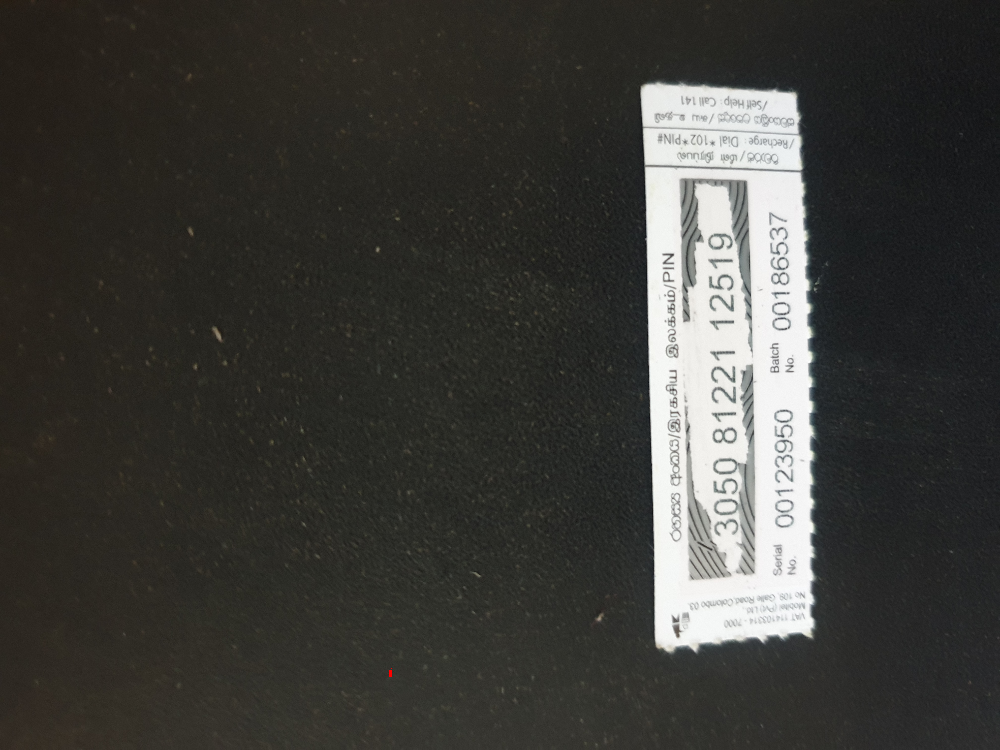

In [10]:
check_image_with_numbers_ocr(f"{card_ds_path}/{image_list[3]}")

### Using Custom Annotations

In [11]:
images_with_ann = ["20220226_190646.jpg","IMG_20220121_195027.jpg","20220123_105856.jpg","20220123_105621.jpg"]

card_image_annotations = "D:\\ACRA\\datasets\\annotated_card_images\\card_image_ann\\annotations.xml"

In [12]:
def annotation_file_to_json(image_name,xml_file_path:str=card_image_annotations):
    tree = ET.parse(xml_file_path)
    root = tree.getroot()
    anno = []

    image_name_attr = ".//image[@name='{}']".format(image_name)
    for image_tag in root.iterfind(image_name_attr):
        image = {}
        for key, value in image_tag.items():
            image[key] = value
        image['shapes'] = []
        for poly_tag in image_tag.iter('polygon'):
            polygon = {'type': 'polygon'}
            for key, value in poly_tag.items():
                polygon[key] = value
            image['shapes'].append(polygon)
        for box_tag in image_tag.iter('box'):
            box = {'type': 'box'}
            for key, value in box_tag.items():
                box[key] = value
            box['points'] = "{0},{1};{2},{1};{2},{3};{0},{3}".format(
                box['xtl'], box['ytl'], box['xbr'], box['ybr'])
            image['shapes'].append(box)
        image['shapes'].sort(key=lambda x: int(x.get('z_order', 0)))
        anno.append(image)
    return anno

In [13]:
annotation_file_to_json("20220226_190646.jpg")

[{'id': '20',
  'name': '20220226_190646.jpg',
  'width': '4032',
  'height': '3024',
  'shapes': [{'type': 'box',
    'label': '0',
    'occluded': '0',
    'source': 'manual',
    'xtl': '1740.87',
    'ytl': '569.56',
    'xbr': '1927.42',
    'ybr': '711.93',
    'z_order': '0',
    'points': '1740.87,569.56;1927.42,569.56;1927.42,711.93;1740.87,711.93'},
   {'type': 'box',
    'label': '0',
    'occluded': '0',
    'source': 'manual',
    'xtl': '1716.33',
    'ytl': '2061.93',
    'xbr': '1917.60',
    'ybr': '2199.38',
    'z_order': '0',
    'points': '1716.33,2061.93;1917.60,2061.93;1917.60,2199.38;1716.33,2199.38'},
   {'type': 'box',
    'label': '0',
    'occluded': '0',
    'source': 'manual',
    'xtl': '2133.60',
    'ytl': '2209.20',
    'xbr': '2300.51',
    'ybr': '2331.93',
    'z_order': '0',
    'points': '2133.60,2209.20;2300.51,2209.20;2300.51,2331.93;2133.60,2331.93'},
   {'type': 'box',
    'label': '0',
    'occluded': '0',
    'source': 'manual',
    'xtl': '

In [14]:
def check_image_with_numbers_ocr(img_path,image_name):
    img = Image.open(img_path)
    ext_json = annotation_file_to_json(image_name)[0]
    img = img.convert("RGB")

    draw = ImageDraw.Draw(img)

    for label in ext_json["shapes"]:
        box = [int(float(label["xtl"])),int(float(label["ytl"])),int(float(label["xbr"])),int(float(label["ybr"]))]
        draw.rectangle(box, outline="red",width=10)
        draw.text((box[0] + 10, box[1] - 10), text=label["label"], fill="red", font=font,width=10)

    return img

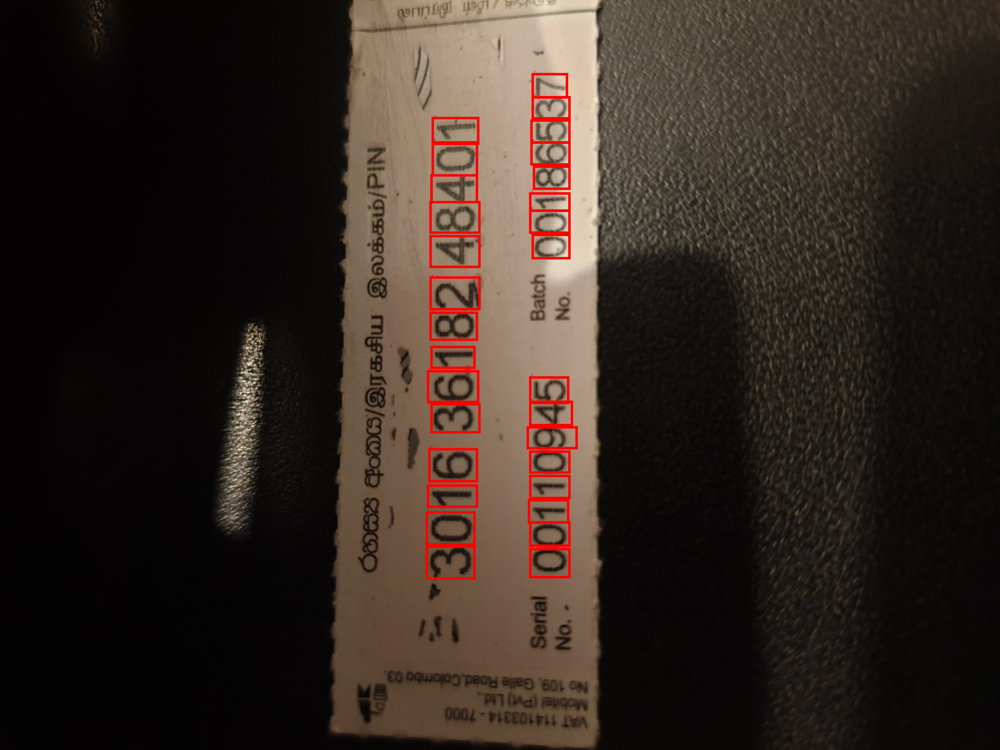

In [15]:
check_image_with_numbers_ocr(f"{card_ds_path}/20220226_190646.jpg","20220226_190646.jpg")

In [16]:
def collect_all_number_images():
    digit_arrays = {}
    for img_name in images_with_ann:
        img = Image.open(f"{card_ds_path}/{img_name}")
        ext_json = annotation_file_to_json(img_name)[0]
        img = np.array(img)
        for label in ext_json["shapes"]:
            box = [int(float(label["xtl"])),int(float(label["ytl"])),int(float(label["xbr"])),int(float(label["ybr"]))]
            if not label["label"] in digit_arrays.keys():
                digit_arrays[label["label"]] = []

            digit_arrays[label["label"]].append(img[box[1]:box[3],box[0]:box[2]])

    return digit_arrays

In [17]:
def rgb_to_luminance(image):
    luminance = 0.299*image[:,:,2]+0.587*image[:,:,1]+0.114*image[:,:,0]
    return luminance.astype(int)

In [18]:

digits = collect_all_number_images()

In [19]:
digits.keys()

dict_keys(['0', '1', '2', '3', '4', '5', '6', '8', '7', '9'])

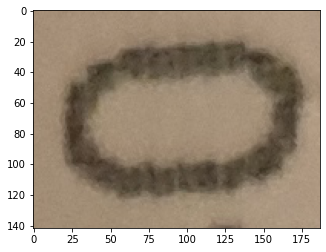

In [20]:
plt.imshow(digits["0"][0])

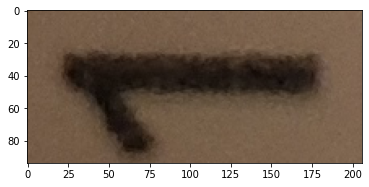

In [21]:
plt.imshow(digits["1"][0])

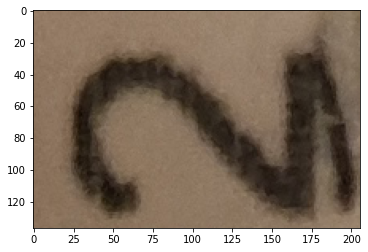

In [22]:
plt.imshow(digits["2"][0])

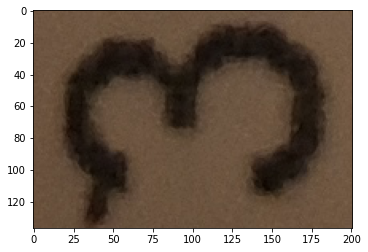

In [23]:
plt.imshow(digits["3"][0])

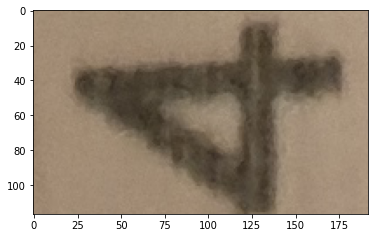

In [24]:
plt.imshow(digits["4"][0])

In [25]:
rgb_to_luminance(digits["4"][0]).shape

(117, 192)

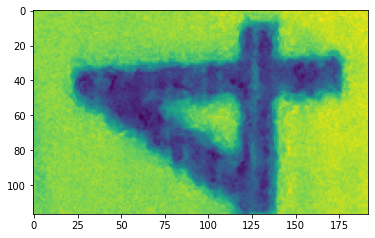

In [26]:
plt.imshow(rgb_to_luminance(digits["4"][0]))

In [27]:
def statistic_collection(digit_array):
    pixel_value = {}
    for _key in digit_array:
        for a_digit in digit_array[_key]:
            unique, counts = np.unique(a_digit, return_counts=True)
            unique = unique.tolist()
            counts = counts.tolist()
            for val_index in range(len(unique)):
                if not unique[val_index] in pixel_value.keys():
                    pixel_value[unique[val_index]] = 0

                pixel_value[unique[val_index]]+=counts[val_index]

    return pixel_value

In [28]:
pixel_value_distribution = statistic_collection(digits)

In [29]:
pixel_value_distribution

{24: 5773,
 30: 6573,
 32: 6526,
 33: 6667,
 34: 6540,
 35: 6474,
 36: 6646,
 37: 6497,
 38: 6476,
 39: 6584,
 40: 6610,
 41: 6527,
 42: 6687,
 43: 6571,
 44: 6608,
 45: 6523,
 46: 6602,
 47: 6838,
 48: 6777,
 49: 6989,
 50: 6975,
 51: 7038,
 52: 7512,
 53: 7496,
 54: 7818,
 55: 7671,
 56: 7912,
 57: 8259,
 58: 8537,
 59: 9144,
 60: 9353,
 61: 10004,
 62: 10406,
 63: 11044,
 64: 11252,
 65: 11711,
 66: 12254,
 67: 12172,
 68: 12420,
 69: 12472,
 70: 12914,
 71: 12730,
 72: 12955,
 73: 13174,
 74: 13316,
 75: 13778,
 76: 14076,
 77: 14240,
 78: 14755,
 79: 15366,
 80: 15727,
 81: 16190,
 82: 16624,
 83: 17160,
 84: 17506,
 85: 17635,
 86: 17736,
 87: 17840,
 88: 17850,
 89: 18128,
 90: 18250,
 91: 18251,
 92: 18218,
 93: 18450,
 94: 18230,
 95: 18318,
 96: 18219,
 97: 18121,
 98: 17908,
 99: 17617,
 100: 17935,
 101: 17650,
 102: 18228,
 103: 18417,
 104: 18537,
 105: 18847,
 106: 19389,
 107: 20008,
 108: 20346,
 109: 20708,
 110: 21405,
 111: 21390,
 112: 21607,
 113: 21487,
 114: 220

In [30]:
x_pixels = [x for x in range(256)]
y_pixels = [pixel_value_distribution[x] for x in range(256)]

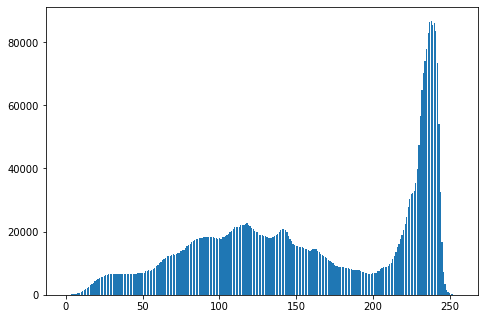

In [31]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(x_pixels,y_pixels)
plt.show()

In [126]:
def histogram_equalization(digit_segment):
    return cv.equalizeHist(digit_segment)


def lower_and_higher_value_shift(digit_segment,limit:int=75):
    t_digit_segment = np.zeros(shape=digit_segment.shape)
    t_digit_segment[digit_segment<=limit] = 5
    t_digit_segment[digit_segment>limit] = 250
    return t_digit_segment

def squeeze_from_sides(digit_segment):
    t_digit_segment = digit_segment.copy()

    row = 0
    while not 5.0 in t_digit_segment[row].tolist():
        row += 1
    t_digit_segment = t_digit_segment[row:,:]

    row = t_digit_segment.shape[0] - 1
    while not 5.0 in t_digit_segment[row].tolist():
        row -= 1
    t_digit_segment = t_digit_segment[:row,:]

    column = 0
    while not 5.0 in t_digit_segment[:,column].tolist():
        column += 1
    t_digit_segment = t_digit_segment[:,column:]

    column = t_digit_segment.shape[1] - 1
    while not 5.0 in t_digit_segment[:,column].tolist():
        column -= 1
    t_digit_segment = t_digit_segment[:,:column]

    return t_digit_segment

In [127]:
def apply_augmentation(digit_array):
    transformed_array = {}
    for _key in digit_array:
        for a_digit in digit_array[_key]:
            transformed = cv.cvtColor(a_digit, cv.COLOR_BGR2GRAY)
            transformed = histogram_equalization(transformed)
            transformed = lower_and_higher_value_shift(transformed)
            transformed = squeeze_from_sides(transformed)

            if not _key in transformed_array.keys():
                transformed_array[_key] = []

            transformed_array[_key].append(transformed)

    return transformed_array


In [128]:
transformed_digits = apply_augmentation(digits)

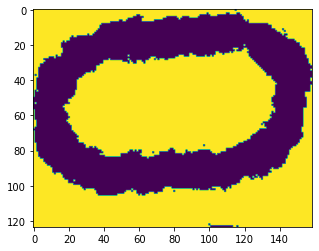

In [129]:
plt.imshow(transformed_digits["0"][0],cmap="grey")

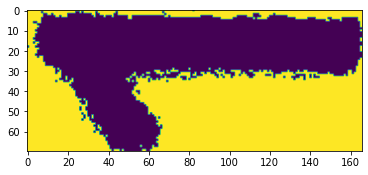

In [130]:
plt.imshow(transformed_digits["1"][0],cmap="grey")

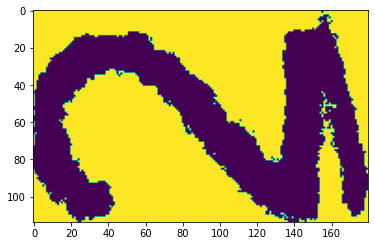

In [131]:
plt.imshow(transformed_digits["2"][0],cmap="grey")

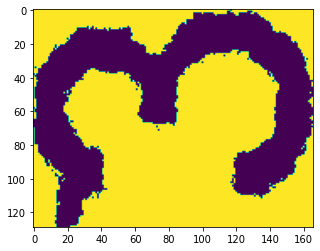

In [132]:
plt.imshow(transformed_digits["3"][0],cmap="grey")

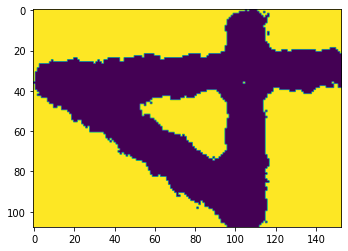

In [133]:
plt.imshow(transformed_digits["4"][0],cmap="grey")

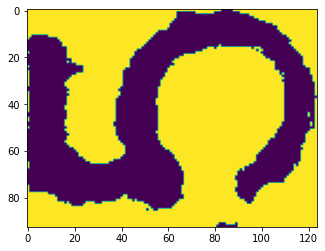

In [134]:
plt.imshow(transformed_digits["5"][0],cmap="grey")

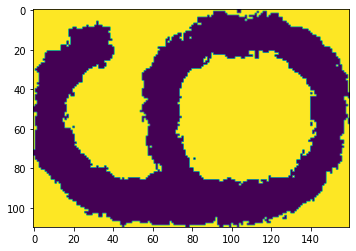

In [135]:
plt.imshow(transformed_digits["6"][0],cmap="grey")

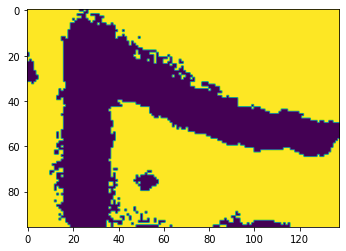

In [136]:
plt.imshow(transformed_digits["7"][0],cmap="grey")

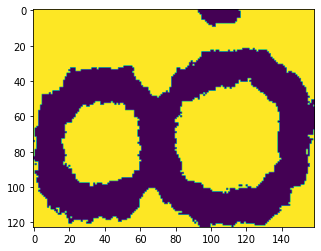

In [137]:
plt.imshow(transformed_digits["8"][0],cmap="grey")

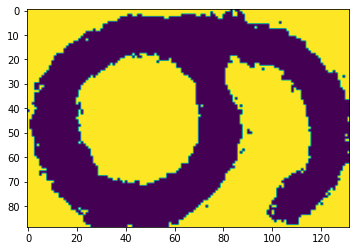

In [138]:
plt.imshow(transformed_digits["9"][0],cmap="grey")

In [139]:
unique, counts = np.unique(transformed_digits["1"][0], return_counts=True)
unique,counts

(array([  5., 250.]), array([5627, 5993], dtype=int64))

In [140]:
pixel_value_distribution = statistic_collection(transformed_digits)

In [141]:
x_pixels = [x for x in range(256)]
y_pixels = [pixel_value_distribution[x] if x in pixel_value_distribution.keys() else 0 for x in range(256)  ]

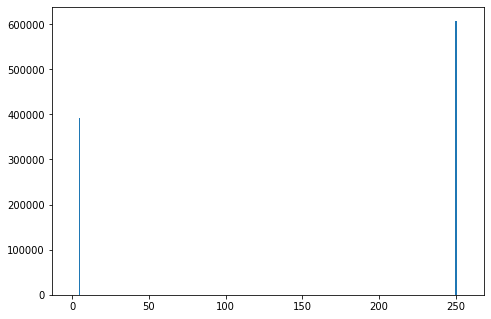

In [142]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(x_pixels,y_pixels)
plt.show()

In [147]:
def size_distribution(digit_array):
    size = []
    width = []
    height = []
    for _key in digit_array:
        for a_digit in digit_array[_key]:
            size.append(a_digit.shape)
            width.append(a_digit.shape[1])
            height.append(a_digit.shape[0])

    print(min(width),max(width))
    print(min(height),max(height))

    return height, width

In [148]:
h_dist,w_dist = size_distribution(transformed_digits)

93 182
40 129
